# YogiVision: Multi-Class Yoga Pose Classification
## DATASCI 281: Foundations of Computer Vision - Final Project

##### Kirthi Shanbhag, Skylar Wang, Omar Zu'bi
---

## Table of Contents
1. [Setup and Data Loading](#1-setup-and-data-loading)
2. [Data Preprocessing](#2-data-preprocessing)
3. [Feature Extraction](#3-feature-extraction)
4. [Perform PCA & T-SNE Analysis](#4-perform-pca--t-sne-analysis)
5. [Classification Models](#5-classification-models)
6. [Efficiency vs Accuracy Analysis](#6-efficiency-vs-accuracy-analysis)
7. [Results and Conclusions](#7-results-and-conclusions)

## 1. Setup and Data Loading

In [1]:
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import shutil
import time
import warnings
warnings.filterwarnings('ignore')

# Image processing
from skimage.feature import hog
import mediapipe as mp

# Machine Learning
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, label_binarize
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score, roc_curve, auc,
    confusion_matrix, classification_report, precision_recall_fscore_support,
    make_scorer
)
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import label_binarize
import seaborn as sns
import matplotlib.pyplot as plt

# Deep Learning
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from tensorflow.keras.models import Model

# Reproducibility
import random
np.random.seed(42)
random.seed(42)

# Control flags
# If True: create augmented images (flips) and save to disk (overwrite)
AUGMENT = False

# If True: recompute all features and overwrite .npy files
# If False: load feature .npy files from disk instead of recomputing
GENERATE_FEATURES = False

# Paths
base_dir      = os.getcwd()
raw_dir       = os.path.join(base_dir, "RAW_DATASET")
dataset_dir   = os.path.join(base_dir, "DATASET")
augmented_dir = os.path.join(dataset_dir, "AUGMENTED")
features_dir  = os.path.join(base_dir, "FEATURES")
results_dir   = os.path.join(base_dir, "RESULTS")

# Classes and image size
CLASSES = [
    'bow', 'bridge', 'child', 'cow', 'dancer', 'downdog', 'gate',
    'goddess', 'lotus', 'plank', 'plow', 'traingle_variation',
    'tree', 'triangle', 'warrior2'
]

print(f"RAW data directory: {raw_dir}")
print(f"Classes ({len(CLASSES)}): {CLASSES}")

RAW data directory: /Users/skylarwang/Documents/GitHub/ucb/fall 25/281/D281_finalproject_yogapose/RAW_DATASET
Classes (15): ['bow', 'bridge', 'child', 'cow', 'dancer', 'downdog', 'gate', 'goddess', 'lotus', 'plank', 'plow', 'traingle_variation', 'tree', 'triangle', 'warrior2']


In [2]:
def load_dataset(data_dir, classes):
    images = []
    labels = []
    image_paths = []
    
    for class_idx, class_name in enumerate(classes):
        class_dir = os.path.join(data_dir, class_name)
        class_images = [
            f for f in os.listdir(class_dir)
            if f.lower().endswith(('.jpg', '.jpeg', '.png'))
        ]
        print(f"Loading {class_name}: {len(class_images)} images")
        
        for img_name in class_images:
            img_path = os.path.join(class_dir, img_name)
            img = cv2.imread(img_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            images.append(img)
            labels.append(class_idx)
            image_paths.append(img_path)
    
    return np.array(images, dtype=object), np.array(labels), np.array(image_paths, dtype=object)

X, y, paths = load_dataset(raw_dir, CLASSES)
print(f"\nDataset loaded: {len(X)} images")
print(f"Label distribution: {np.bincount(y)}")

Loading bow: 86 images
Loading bridge: 112 images
Loading child: 122 images
Loading cow: 188 images
Loading dancer: 127 images
Loading downdog: 591 images


libpng warning: cHRM: inconsistent chromaticities
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile


Loading gate: 74 images
Loading goddess: 392 images


Corrupt JPEG data: premature end of data segment


Loading lotus: 118 images
Loading plank: 420 images
Loading plow: 104 images
Loading traingle_variation: 256 images
Loading tree: 498 images


Premature end of JPEG file


Loading triangle: 102 images
Loading warrior2: 454 images

Dataset loaded: 3644 images
Label distribution: [ 86 112 122 188 127 591  74 392 118 420 104 256 498 102 454]


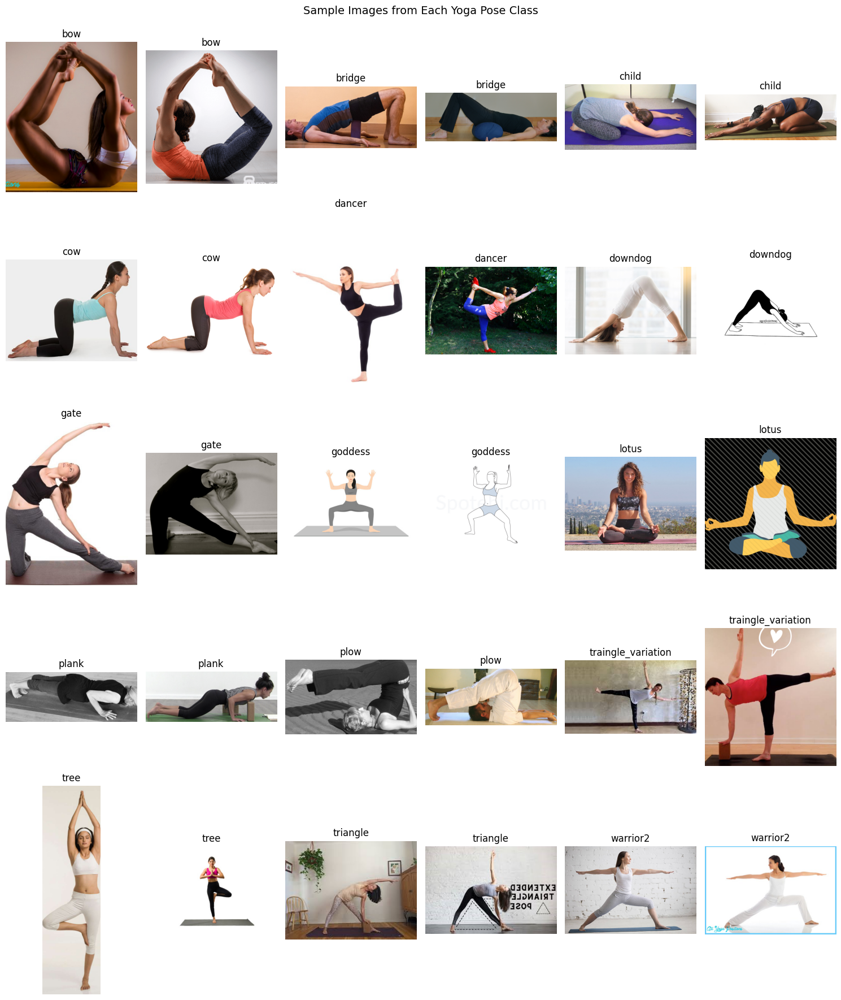

In [3]:
# Visualize some samples (2 per class)
fig, axes = plt.subplots(5, 6, figsize=(15, 18))
axes = axes.ravel()

for class_idx, class_name in enumerate(CLASSES):
    class_indices = np.where(y == class_idx)[0]
    if len(class_indices) < 2:
        continue
    sample_indices = np.random.choice(class_indices, 2, replace=False)
    
    for i, idx in enumerate(sample_indices):
        ax = axes[class_idx * 2 + i]
        ax.imshow(X[idx])
        ax.set_title(class_name)
        ax.axis('off')

plt.suptitle("Sample Images from Each Yoga Pose Class", fontsize=14)
plt.tight_layout()
plt.show()


## 2. Data Preprocessing

In [4]:
# Split data into train, validation, and test sets
# Stratified split: 70% temp, 30% test
X_temp, X_test, y_temp, y_test, paths_temp, paths_test = train_test_split(
    X, y, paths, test_size=0.3, random_state=42, stratify=y
)

# From temp: 80% train, 20% val
X_train_raw, X_val, y_train_raw, y_val, paths_train_raw, paths_val = train_test_split(
    X_temp, y_temp, paths_temp, test_size=0.2, random_state=42, stratify=y_temp
)

print("Dataset split (RAW, BEFORE augmentation):")
print(f"Training set:   {len(X_train_raw)} images")
print(f"Validation set: {len(X_val)} images")
print(f"Test set:       {len(X_test)} images")

Dataset split (RAW, BEFORE augmentation):
Training set:   2040 images
Validation set: 510 images
Test set:       1094 images


In [5]:
def augment_dataset(images, labels, image_paths, output_dir):
    """
    Returns a complete augmented dataset:
        original images + flipped images.

    Behavior:
    ----------
    If AUGMENT = True:
        - Delete output_dir completely.
        - Recreate full augmented dataset from scratch.
        - Save originals + flips.

    If AUGMENT = False:
        - Load augmented dataset from disk.
        - If any augmented file is missing, regenerate and SAVE IT.
        - Never delete folder.
    """

    augmented_images = []
    augmented_labels = []
    augmented_paths = []

    if AUGMENT:
        print("Regenerating all augmentations and overwriting folder...")
        # Delete old folder
        shutil.rmtree(output_dir)
        # Recreate empty folder
        for cls in CLASSES:
            os.makedirs(os.path.join(output_dir, cls), exist_ok=True)

    for img, label, path in zip(images, labels, image_paths):

        class_name = CLASSES[label]
        class_dir = os.path.join(output_dir, class_name)
        os.makedirs(class_dir, exist_ok=True)

        original_filename = os.path.basename(path)
        name, ext = os.path.splitext(original_filename)

        # Original Image
        orig_out_path = os.path.join(class_dir, original_filename)

        # Save only when regenerating
        if AUGMENT:
            img_bgr = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
            cv2.imwrite(orig_out_path, img_bgr)

        # Append to dataset
        augmented_images.append(img)
        augmented_labels.append(label)
        augmented_paths.append(orig_out_path)

        # Flipped Image
        flip_filename = f"{name}_flip{ext}"
        flip_out_path = os.path.join(class_dir, flip_filename)

        if AUGMENT:
            flipped = cv2.flip(img, 1)
            flipped_bgr = cv2.cvtColor(flipped, cv2.COLOR_RGB2BGR)
            cv2.imwrite(flip_out_path, flipped_bgr)

        else:
            if os.path.exists(flip_out_path):
                flipped = cv2.cvtColor(cv2.imread(flip_out_path), cv2.COLOR_BGR2RGB)
            else:
                print(f"[WARN] Missing augmented image. Regenerating: {flip_out_path}")
                flipped = cv2.flip(img, 1)
                flipped_bgr = cv2.cvtColor(flipped, cv2.COLOR_RGB2BGR)
                cv2.imwrite(flip_out_path, flipped_bgr)

        # Add flipped image to dataset
        augmented_images.append(flipped)
        augmented_labels.append(label)
        augmented_paths.append(flip_out_path)

    return (
        np.array(augmented_images, dtype=object),
        np.array(augmented_labels),
        np.array(augmented_paths, dtype=object)
    )


# Run Augmentation
X_train, y_train, paths_train = augment_dataset(
    X_train_raw, y_train_raw, paths_train_raw, augmented_dir
)

print(f"\nTraining Set Size (AFTER augmentation): {len(X_train)}")
print(f"Validation Set Size: {len(X_val)}")
print(f"Test Set Size:       {len(X_test)}")



Training Set Size (AFTER augmentation): 4080
Validation Set Size: 510
Test Set Size:       1094


## 3. Feature Extraction

We implement three types of features:
1. **Simple Feature 1:** Histogram of Oriented Gradients (HOG)
2. **Simple Feature 2:** Edge Lines
3. **Complex Feature 1:** MediaPose (Connections & Landmarks)
3. **Complex Feature 2:** Pre-trained ResNet50 Deep Features

In [6]:
def feature_path(feature_type, class_name, filename):
    """Return storage path for a single feature file."""
    class_dir = os.path.join(features_dir, feature_type, class_name)
    os.makedirs(class_dir, exist_ok=True)
    return os.path.join(class_dir, filename + ".npy")


def save_feature(feature_type, class_name, filename, feature_vector):
    path = feature_path(feature_type, class_name, filename)
    np.save(path, feature_vector)


def load_feature(feature_type, class_name, filename):
    path = feature_path(feature_type, class_name, filename)
    if os.path.exists(path):
        return np.load(path)
    return None

In [7]:
def extract_hog(img, visualize=False):
    """Return 1D HOG vector, and optionally a visualization image."""
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gray = cv2.resize(gray, (256, 256))
    gray = gray.astype("float32") / 255.0

    if visualize:
        feat, hog_img = hog(
            gray,
            orientations=12,
            pixels_per_cell=(8, 8),
            cells_per_block=(2, 2),
            visualize=True
        )
        return feat, hog_img

    feat = hog(
        gray,
        orientations=12,
        pixels_per_cell=(8, 8),
        cells_per_block=(2, 2),
        visualize=False
    )
    return feat


def extract_hog_set(images, labels, paths):
    features = []
    for img, label, path in tqdm(zip(images, labels, paths), total=len(images),
                                 desc="Extracting HOG"):
        
        filename = os.path.splitext(os.path.basename(path))[0]
        class_name = CLASSES[label]

        # Load if exists
        if not GENERATE_FEATURES:
            feat = load_feature("HOG", class_name, filename)
            if feat is not None:
                features.append(feat)
                continue

        # Compute feature
        feat = extract_hog(img)

        # Save
        save_feature("HOG", class_name, filename, feat)

        features.append(feat)
    
    return np.array(features)

In [8]:
def _extract_contour_single(img):
    """Extract contour features for a single image (same math as your code)."""

    if img.ndim == 3:
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    else:
        gray = img.copy()

    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    edges = cv2.Canny(blurred, 50, 150)

    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if len(contours) > 0:
        c = max(contours, key=cv2.contourArea)

        area = cv2.contourArea(c)
        peri = cv2.arcLength(c, True)

        x, y, w, h = cv2.boundingRect(c)
        aspect = w / h if h > 0 else 0
        extent = area / (w*h) if w*h > 0 else 0

        hull = cv2.convexHull(c)
        hull_area = cv2.contourArea(hull)
        solidity = area / hull_area if hull_area > 0 else 0

        M = cv2.moments(c)
        cx = M["m10"]/M["m00"] if M["m00"] != 0 else 0
        cy = M["m01"]/M["m00"] if M["m00"] != 0 else 0

        return np.array([area, peri, aspect, extent, solidity, cx, cy], dtype=np.float32)

    else:
        return np.zeros(7, dtype=np.float32)
def extract_contour_features(images, labels=None, image_paths=None,
                             save_features_to_disk=False, visualize=False):

    features = []
    vis_images = []

    feature_dir = os.path.join(features_dir, "contour")

    if save_features_to_disk and labels is not None:
        for class_name in CLASSES:
            os.makedirs(os.path.join(feature_dir, class_name), exist_ok=True)

    for img in tqdm(images, desc="Extracting contour features"):
        feat = _extract_contour_single(img) 
        features.append(feat)

        if visualize:
            if img.ndim == 3:
                gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
            else:
                gray = img.copy()
            blurred = cv2.GaussianBlur(gray, (5, 5), 0)
            edges = cv2.Canny(blurred, 50, 150)
            vis_images.append(edges)

    if visualize:
        return np.array(features), vis_images

    return np.array(features)
    
def extract_contour_set(images, labels, paths):
    features = []
    
    for img, label, path in tqdm(zip(images, labels, paths), total=len(images),
                                 desc="Extracting Contour Features"):
        
        filename = os.path.splitext(os.path.basename(path))[0]
        class_name = CLASSES[label]

        if not GENERATE_FEATURES:
            feat = load_feature("CONTOUR", class_name, filename)
            if feat is not None:
                features.append(feat)
                continue

        feat = _extract_contour_single(img)

        save_feature("CONTOUR", class_name, filename, feat)
        features.append(feat)

    return np.array(features)


In [9]:
mp_pose = mp.solutions.pose
mp_drawing = mp.solutions.drawing_utils
pose_estimator = mp_pose.Pose(static_image_mode=True, model_complexity=2)


def extract_mediapipe_features(img):
    """
    MediaPipe feature vector:
    132 landmark features (x,y,z,visibility)
    + 8 geometric distances
    = 140 total
    """
    img_bgr = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    res = pose_estimator.process(img_bgr)

    if res.pose_landmarks is None:
        return np.zeros(140)

    lm = res.pose_landmarks.landmark

    # Raw 132 features
    landmark_features = []
    for p in lm:
        landmark_features.extend([p.x, p.y, p.z, p.visibility])

    # 8 geometric distances
    def dist(a, b):
        return np.sqrt((a.x - b.x)**2 + (a.y - b.y)**2)

    L = mp_pose.PoseLandmark

    geometric = [
        dist(lm[L.LEFT_SHOULDER], lm[L.RIGHT_SHOULDER]),
        dist(lm[L.LEFT_HIP],      lm[L.RIGHT_HIP]),
        dist(lm[L.LEFT_SHOULDER], lm[L.LEFT_HIP]),
        dist(lm[L.RIGHT_SHOULDER],lm[L.RIGHT_HIP]),
        dist(lm[L.LEFT_HIP],      lm[L.LEFT_KNEE]),
        dist(lm[L.RIGHT_HIP],     lm[L.RIGHT_KNEE]),
        dist(lm[L.LEFT_KNEE],     lm[L.LEFT_ANKLE]),
        dist(lm[L.RIGHT_KNEE],    lm[L.RIGHT_ANKLE])
    ]

    return np.array(landmark_features + geometric)


def extract_mediapipe_set(images, labels, paths):
    features = []

    for img, label, path in tqdm(zip(images, labels, paths), total=len(images),
                                 desc="Extracting MediaPipe Features"):

        filename = os.path.splitext(os.path.basename(path))[0]
        class_name = CLASSES[label]

        if not GENERATE_FEATURES:
            feat = load_feature("MEDIAPIPE", class_name, filename)
            if feat is not None:
                features.append(feat)
                continue

        feat = extract_mediapipe_features(img)
        save_feature("MEDIAPIPE", class_name, filename, feat)
        features.append(feat)

    return np.array(features)


I0000 00:00:1765230725.210006  594363 gl_context.cc:357] GL version: 2.1 (2.1 Metal - 90.5), renderer: Apple M1 Pro


In [10]:
# Load pretrained ImageNet ResNet50
resnet_base = ResNet50(weights="imagenet", include_top=False, pooling="avg")

# Use global pooling output as feature vector
resnet_model = Model(inputs=resnet_base.input, outputs=resnet_base.output)

def extract_resnet_features(img):
    # Resize once
    img_resized = cv2.resize(img, (224, 224)).astype(np.float32)

    x = np.empty((1, 224, 224, 3), dtype=np.float32)
    x[0] = preprocess_input(img_resized)
    feat = resnet_model(x, training=False).numpy()
    return feat[0]


def extract_resnet_set(images, labels, paths):
    features = []
    
    for img, label, path in tqdm(zip(images, labels, paths), total=len(images),
                                 desc="Extracting ResNet Features"):

        filename = os.path.splitext(os.path.basename(path))[0]
        class_name = CLASSES[label]

        if not GENERATE_FEATURES:
            feat = load_feature("RESNET", class_name, filename)
            if feat is not None:
                features.append(feat)
                continue

        # Faster feature extraction
        feat = extract_resnet_features(img)

        save_feature("RESNET", class_name, filename, feat)
        features.append(feat)

    return np.array(features)


INFO: Created TensorFlow Lite XNNPACK delegate for CPU.


In [11]:
print("\nExtracting ALL feature types...\n")

hog_train     = extract_hog_set(X_train, y_train, paths_train)
hog_val       = extract_hog_set(X_val,   y_val,   paths_val)
hog_test      = extract_hog_set(X_test,  y_test,  paths_test)

contour_train = extract_contour_set(X_train, y_train, paths_train)
contour_val   = extract_contour_set(X_val,   y_val,   paths_val)
contour_test  = extract_contour_set(X_test,  y_test,  paths_test)

mediapipe_train = extract_mediapipe_set(X_train, y_train, paths_train)
mediapipe_val   = extract_mediapipe_set(X_val,   y_val,   paths_val)
mediapipe_test  = extract_mediapipe_set(X_test,  y_test,  paths_test)

resnet_train = extract_resnet_set(X_train, y_train, paths_train)
resnet_val   = extract_resnet_set(X_val,   y_val,   paths_val)
resnet_test  = extract_resnet_set(X_test,  y_test,  paths_test)

print("\nFeature extraction complete!")



Extracting ALL feature types...



Extracting ResNet Features: 100%|█████████| 1094/1094 [00:00<00:00, 5935.49it/s]


Feature extraction complete!


### Feature Visualizations


Visualizing HOG Features (5 per class)...


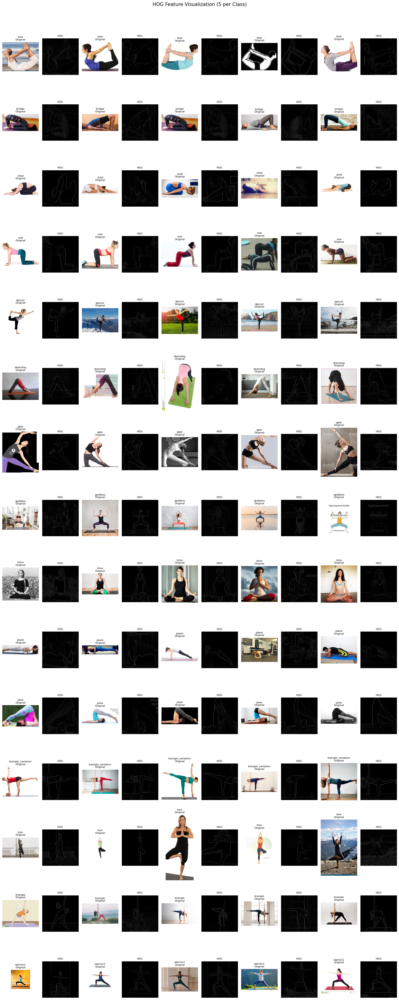

In [12]:
n_show = 5
num_classes = len(CLASSES)
print("\nVisualizing HOG Features (5 per class)...")

fig, axes = plt.subplots(num_classes, n_show * 2, figsize=(n_show * 3.5, num_classes * 3))

for class_idx, class_name in enumerate(CLASSES):
    idxs = np.where(y_train == class_idx)[0]
    if len(idxs) == 0: continue

    chosen = np.random.choice(idxs, n_show, replace=len(idxs) < n_show)

    for j, img_idx in enumerate(chosen):
        orig = X_train[img_idx]
        _, hog_vis = extract_hog(orig, visualize=True)

        axes[class_idx, j*2].imshow(orig)
        axes[class_idx, j*2].set_title(f"{class_name}\nOriginal", fontsize=8)
        axes[class_idx, j*2].axis("off")

        axes[class_idx, j*2+1].imshow(hog_vis, cmap="gray")
        axes[class_idx, j*2+1].set_title("HOG", fontsize=8)
        axes[class_idx, j*2+1].axis("off")

plt.suptitle("HOG Feature Visualization (5 per Class)", fontsize=15)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()



Visualizing Contour Features (5 per class)...


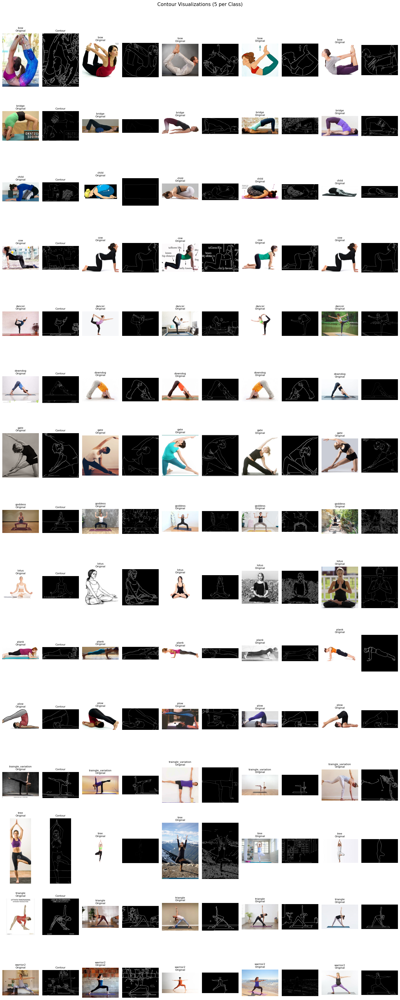

In [13]:
print("\nVisualizing Contour Features (5 per class)...")

fig, axes = plt.subplots(num_classes, n_show * 2, figsize=(n_show * 3.5, num_classes * 3))

for class_idx, class_name in enumerate(CLASSES):
    idxs = np.where(y_train == class_idx)[0]
    chosen = np.random.choice(idxs, n_show, replace=len(idxs) < n_show)

    for j, img_idx in enumerate(chosen):

        # Original Image
        orig = X_train[img_idx]
        axes[class_idx, j*2].imshow(orig)
        axes[class_idx, j*2].set_title(f"{class_name}\nOriginal", fontsize=8)
        axes[class_idx, j*2].axis("off")

        # Contour
        gray = cv2.cvtColor(orig, cv2.COLOR_RGB2GRAY)
        blurred = cv2.GaussianBlur(gray, (5,5), 0)
        edges = cv2.Canny(blurred, 50, 150)
        contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        outline = np.zeros_like(gray)
        cv2.drawContours(outline, contours, -1, 255, 1)

        axes[class_idx, j*2 + 1].imshow(outline, cmap="gray")
        axes[class_idx, j*2 + 1].set_title("Contour" if j == 0 else "", fontsize=8)
        axes[class_idx, j*2 + 1].axis("off")

plt.suptitle("Contour Visualizations (5 per Class)", fontsize=15)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()



Visualizing MediaPipe Pose (5 per class)...


I0000 00:00:1765230754.964933  594363 gl_context.cc:357] GL version: 2.1 (2.1 Metal - 90.5), renderer: Apple M1 Pro


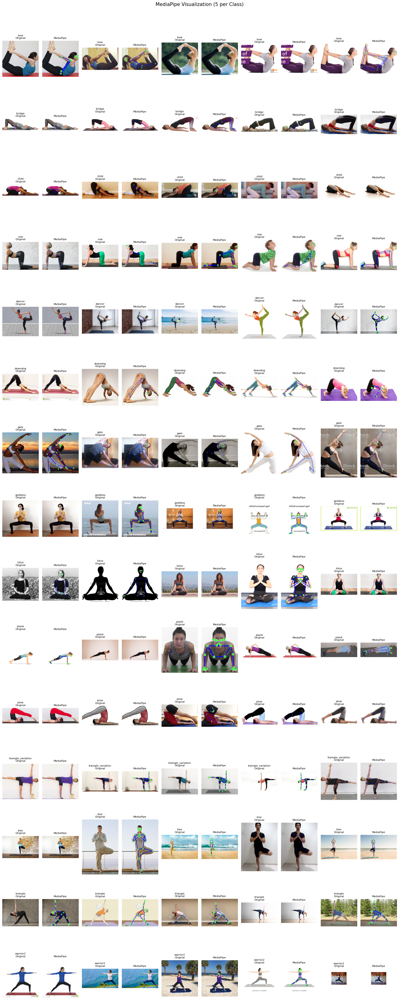

In [14]:
import mediapipe as mp

mp_pose = mp.solutions.pose
mp_drawing = mp.solutions.drawing_utils

pose_vis = mp_pose.Pose(
    static_image_mode=True,
    model_complexity=2,
    enable_segmentation=False,
    min_detection_confidence=0.5
)

def mediapipe_draw(img):
    """
    Returns a MediaPipe pose-annotated visualization of a single image.
    """
    img_bgr = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    res = pose_vis.process(img_bgr)

    annotated = img.copy()

    if res.pose_landmarks:
        mp_drawing.draw_landmarks(
            annotated,
            res.pose_landmarks,
            mp_pose.POSE_CONNECTIONS,
            mp_drawing.DrawingSpec(color=(0,255,0), thickness=2, circle_radius=2),
            mp_drawing.DrawingSpec(color=(0,0,255), thickness=2)
        )

    return annotated

print("\nVisualizing MediaPipe Pose (5 per class)...")

fig, axes = plt.subplots(num_classes, n_show * 2, figsize=(n_show * 3.5, num_classes * 3))

for class_idx, class_name in enumerate(CLASSES):

    idxs = np.where(y_train == class_idx)[0]
    if len(idxs) == 0:
        continue

    chosen = np.random.choice(idxs, n_show, replace=len(idxs) < n_show)

    for j, img_idx in enumerate(chosen):

        orig = X_train[img_idx]
        mp_vis = mediapipe_draw(orig)   # ← visualization only

        axes[class_idx, j * 2].imshow(orig)
        axes[class_idx, j * 2].set_title(f"{class_name}\nOriginal", fontsize=8)
        axes[class_idx, j * 2].axis("off")

        axes[class_idx, j * 2 + 1].imshow(mp_vis)
        axes[class_idx, j * 2 + 1].set_title("MediaPipe", fontsize=8)
        axes[class_idx, j * 2 + 1].axis("off")

plt.suptitle("MediaPipe Visualization (5 per Class)", fontsize=15)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()



Visualizing ResNet Heatmaps (5 per class)...


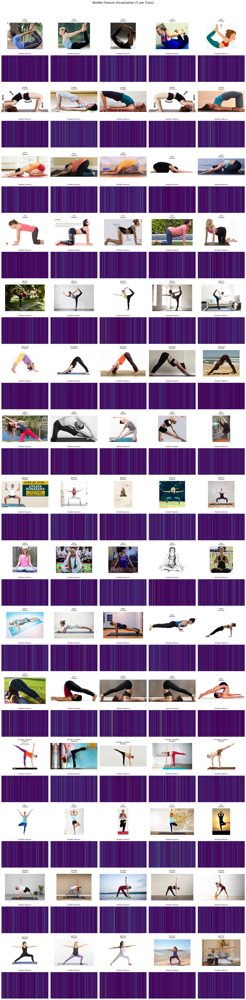

In [15]:
print("\nVisualizing ResNet Heatmaps (5 per class)...")

rows = num_classes * 2   # 2 rows per class
cols = n_show

fig, axes = plt.subplots(rows, cols, figsize=(cols * 3.5, rows * 2.4))

for class_idx, class_name in enumerate(CLASSES):

    idxs = np.where(y_train == class_idx)[0]
    if len(idxs) == 0:
        continue

    chosen = np.random.choice(idxs, n_show, replace=len(idxs) < n_show)

    # Row indices for this class
    row_orig = class_idx * 2
    row_feat = class_idx * 2 + 1

    for j, img_idx in enumerate(chosen):

        orig = X_train[img_idx]

        feat = extract_resnet_features(orig)
        heatmap = np.abs(feat)
        heatmap = (heatmap - heatmap.min()) / (heatmap.max() - heatmap.min() + 1e-8)

        heatmap_vis = np.repeat(heatmap.reshape(1, -1), 20, axis=0)

        ax_orig = axes[row_orig, j]
        ax_feat = axes[row_feat, j]

        # Original image
        ax_orig.imshow(orig)
        ax_orig.set_title(f"{class_name}\nOriginal", fontsize=8)
        ax_orig.axis("off")

        # Heatmap
        sns.heatmap(
            heatmap_vis,
            cmap="viridis",
            cbar=False,
            xticklabels=False,
            yticklabels=False,
            ax=ax_feat
        )
        ax_feat.set_title("ResNet Features", fontsize=8)
        ax_feat.axis("off")

plt.suptitle("ResNet Feature Visualization (5 per Class)", fontsize=15)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()


## 4. Perform PCA & T-SNE Analysis



Generating PCA Scree Plots...



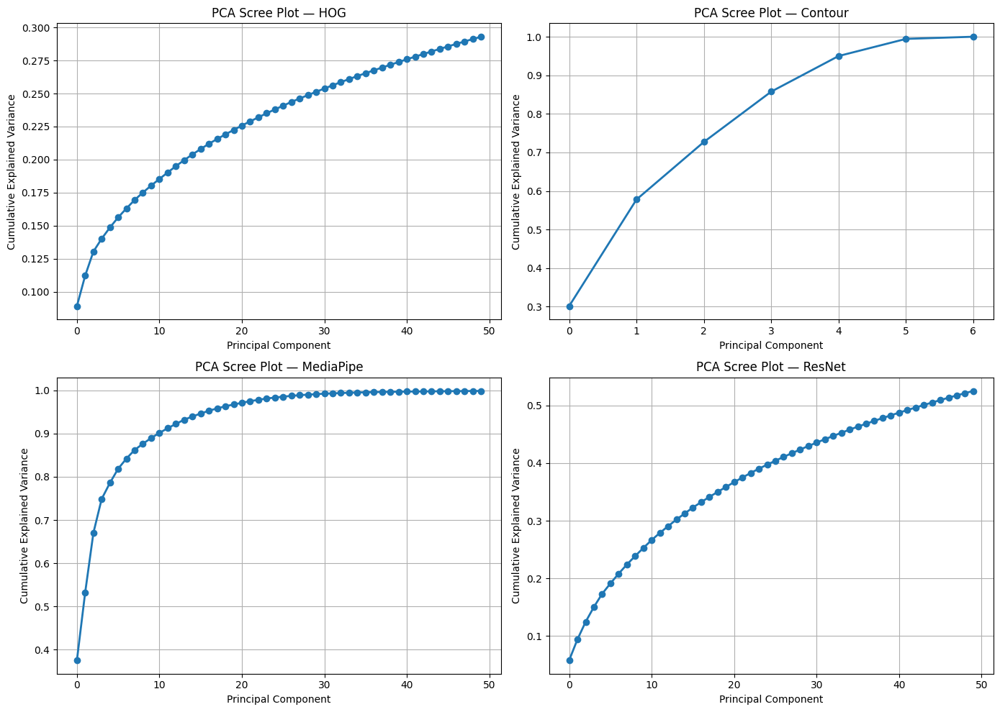

In [16]:
print("\nGenerating PCA Scree Plots...\n")

max_components = 50  # enough to see curvature

fig, axes = plt.subplots(2, 2, figsize=(14, 10))
axes = axes.ravel()

feature_names = ["HOG", "Contour", "MediaPipe", "ResNet"]
feature_sets  = [hog_train, contour_train, mediapipe_train, resnet_train]

for idx, (name, Xf) in enumerate(zip(feature_names, feature_sets)):
    ax = axes[idx]

    # Standardize before PCA
    X_scaled = StandardScaler().fit_transform(Xf)

    pca = PCA(n_components=min(max_components, X_scaled.shape[1]))
    pca.fit(X_scaled)

    ax.plot(np.cumsum(pca.explained_variance_ratio_), marker="o", linewidth=2)
    ax.set_title(f"PCA Scree Plot — {name}", fontsize=12)
    ax.set_xlabel("Principal Component")
    ax.set_ylabel("Cumulative Explained Variance")
    ax.grid(True)

plt.tight_layout()
plt.show()



Plotting per-dimension feature variance for all feature types...



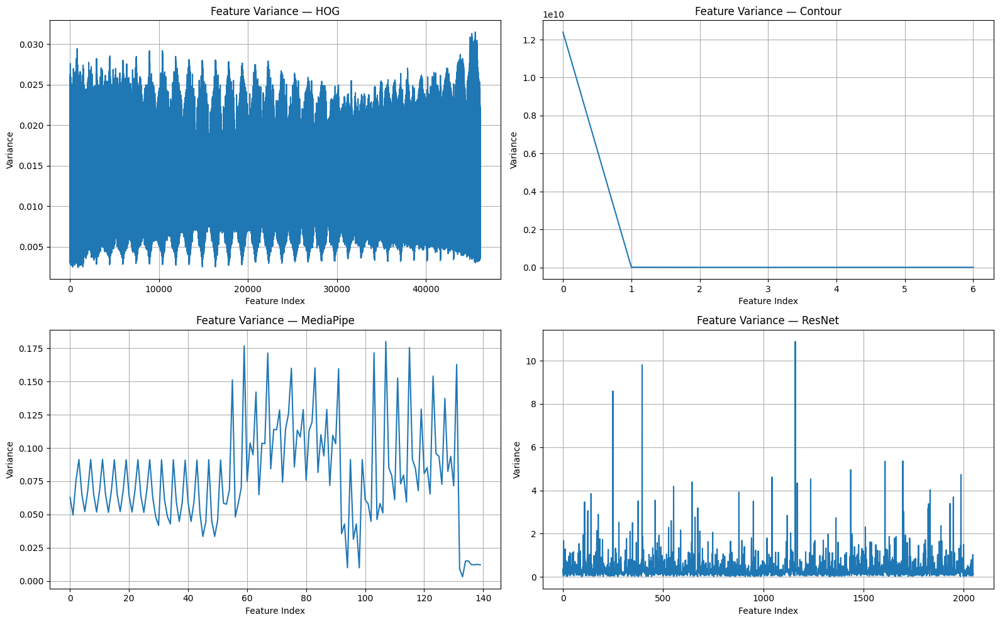

In [17]:
print("\nPlotting per-dimension feature variance for all feature types...\n")

fig, axes = plt.subplots(2, 2, figsize=(16, 10))
axes = axes.ravel()

for idx, (name, Xf) in enumerate(zip(feature_names, feature_sets)):
    ax = axes[idx]
    variances = np.var(Xf, axis=0)

    ax.plot(variances)
    ax.set_title(f"Feature Variance — {name}", fontsize=12)
    ax.set_xlabel("Feature Index")
    ax.set_ylabel("Variance")
    ax.grid(True)

plt.tight_layout()
plt.show()


Generating class-wise feature distribution plots...



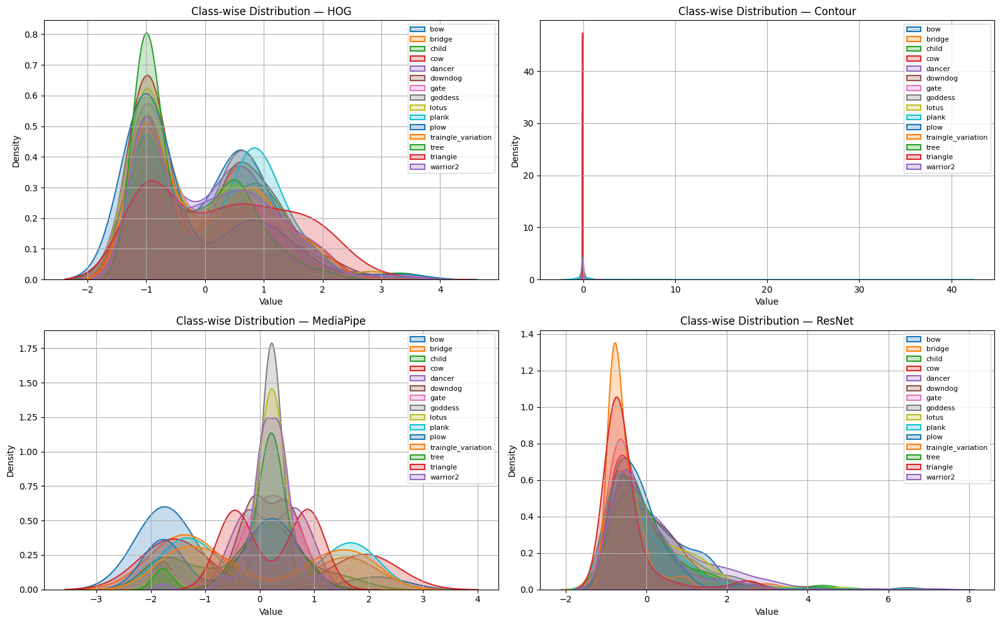

In [28]:
print("\nGenerating class-wise feature distribution plots...\n")

example_feature_idx = 0  # feature dimension to visualize

fig, axes = plt.subplots(2, 2, figsize=(16, 10))
axes = axes.ravel()

for idx, name in enumerate(feature_names):
    ax = axes[idx]
    Xf = feature_sets[idx]

    # Standardize features for visualization
    Xf_vis = StandardScaler().fit_transform(Xf)

    for cls_id, cls_name in enumerate(CLASSES):
        values = Xf_vis[y_train == cls_id][:, example_feature_idx]

        sns.kdeplot(
            values,
            fill=True,
            alpha=0.25,
            linewidth=1.5,
            ax=ax,
            label=cls_name
        )

    ax.set_title(f"Class-wise Distribution — {name}", fontsize=12)
    ax.set_xlabel("Value")
    ax.set_ylabel("Density")
    ax.grid(True)
    ax.legend(fontsize=8)

plt.tight_layout()
plt.show()



Running PCA 2D Projections...



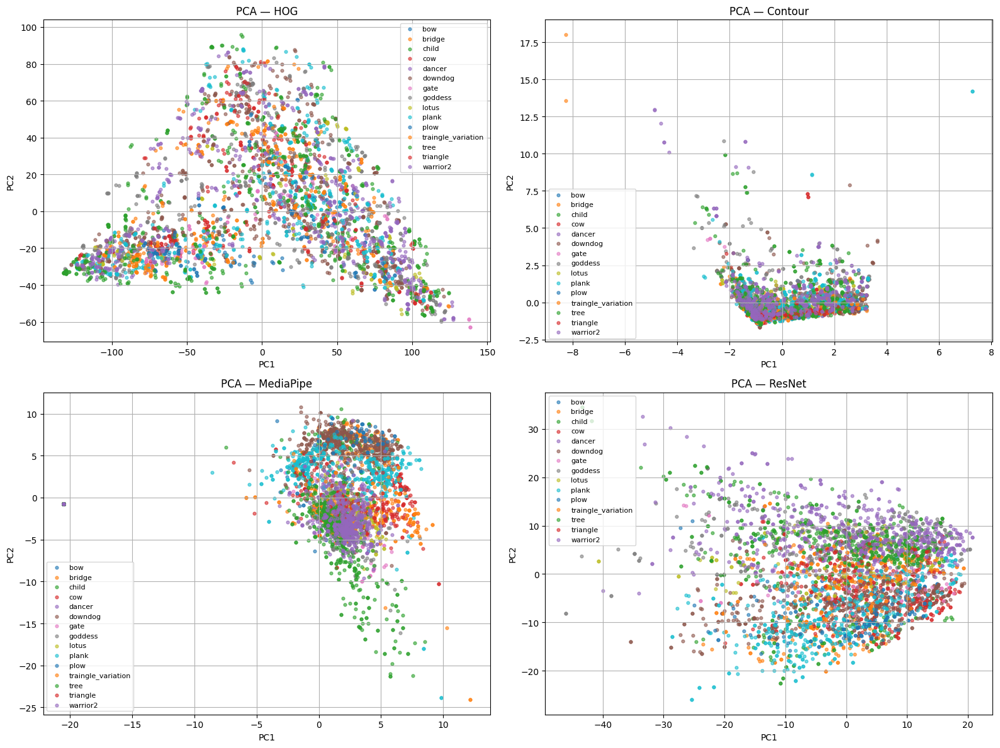

In [22]:
print("\nRunning PCA 2D Projections...\n")

fig, axes = plt.subplots(2, 2, figsize=(16, 12))
axes = axes.ravel()

for idx, name in enumerate(feature_names):
    ax = axes[idx]
    Xf = feature_sets[idx]

    # Standardize full feature set
    X_scaled = StandardScaler().fit_transform(Xf)

    # PCA to 2 dimensions
    pca = PCA(n_components=2)
    Xp = pca.fit_transform(X_scaled)

    # Plot each class
    for c in range(len(CLASSES)):
        pts = Xp[y_train == c]
        ax.scatter(pts[:, 0], pts[:, 1], alpha=0.6, s=12, label=CLASSES[c])

    ax.set_title(f"PCA — {name}", fontsize=12)
    ax.set_xlabel("PC1")
    ax.set_ylabel("PC2")
    ax.legend(fontsize=8)
    ax.grid(True)

plt.tight_layout()
plt.show()



Running t-SNE Visualizations...



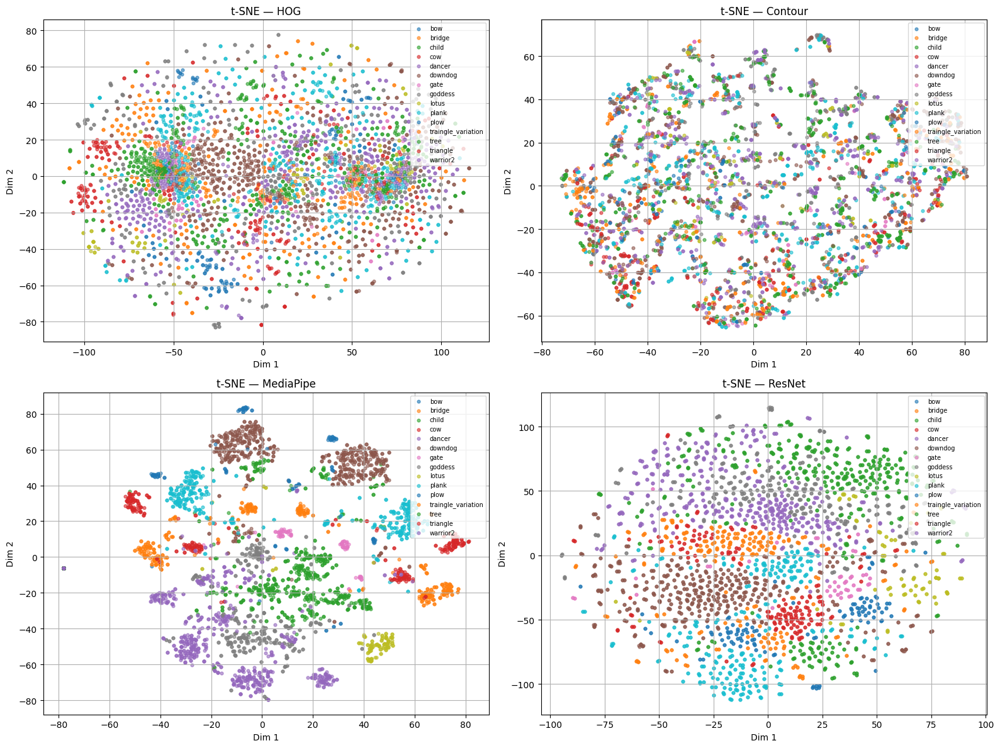

In [27]:
print("\nRunning t-SNE Visualizations...\n")

fig, axes = plt.subplots(2, 2, figsize=(16, 12))
axes = axes.ravel()

for idx, name in enumerate(feature_names):
    ax = axes[idx]
    Xf = feature_sets[idx]

    # Standardize full feature set
    X_scaled = StandardScaler().fit_transform(Xf)

    # Run t-SNE
    tsne = TSNE(n_components=2, perplexity=30, random_state=42)
    Xt = tsne.fit_transform(X_scaled)

    # Scatter for each class
    for c, cls_name in enumerate(CLASSES):
        pts = Xt[y_train == c]
        ax.scatter(
            pts[:, 0],
            pts[:, 1],
            alpha=0.6,
            s=12,
            label=cls_name
        )

    ax.set_title(f"t-SNE — {name}", fontsize=12)
    ax.set_xlabel("Dim 1")
    ax.set_ylabel("Dim 2")
    ax.legend(loc="upper right", fontsize=7)
    ax.grid(True)

plt.tight_layout()
plt.show()


## 5. Classification Models

We implement two different classifiers:
1. **Support Vector Machine (SVM)** 
2. **Logistic Regression** 

In [52]:
def concat(*arrays):
    """Concatenate feature arrays along axis=1."""
    return np.concatenate(arrays, axis=1)

# Base feature sets
features_dict = {
    "HOG":       (hog_train,       hog_val,       hog_test),
    "Contour":   (contour_train,   contour_val,   contour_test),
    "MediaPipe": (mediapipe_train, mediapipe_val, mediapipe_test),
    "ResNet":    (resnet_train,    resnet_val,    resnet_test),
}

# 2-FEATURE COMBINATIONS

features_dict["HOG + Contour"] = (
    concat(hog_train, contour_train),
    concat(hog_val,   contour_val),
    concat(hog_test,  contour_test)
)

features_dict["HOG + MediaPipe"] = (
    concat(hog_train, mediapipe_train),
    concat(hog_val,   mediapipe_val),
    concat(hog_test,  mediapipe_test)
)

features_dict["HOG + ResNet"] = (
    concat(hog_train, resnet_train),
    concat(hog_val,   resnet_val),
    concat(hog_test,  resnet_test)
)

features_dict["Contour + MediaPipe"] = (
    concat(contour_train, mediapipe_train),
    concat(contour_val,   mediapipe_val),
    concat(contour_test,  mediapipe_test)
)

features_dict["Contour + ResNet"] = (
    concat(contour_train, resnet_train),
    concat(contour_val,   resnet_val),
    concat(contour_test,  resnet_test)
)

features_dict["MediaPipe + ResNet"] = (
    concat(mediapipe_train, resnet_train),
    concat(mediapipe_val,   resnet_val),
    concat(mediapipe_test,  resnet_test)
)

# 3-FEATURE COMBINATIONS

features_dict["HOG + Contour + MediaPipe"] = (
    concat(hog_train, contour_train, mediapipe_train),
    concat(hog_val,   contour_val,   mediapipe_val),
    concat(hog_test,  contour_test,  mediapipe_test)
)

features_dict["HOG + Contour + ResNet"] = (
    concat(hog_train, contour_train, resnet_train),
    concat(hog_val,   contour_val,   resnet_val),
    concat(hog_test,  contour_test,  resnet_test)
)

features_dict["HOG + MediaPipe + ResNet"] = (
    concat(hog_train, mediapipe_train, resnet_train),
    concat(hog_val,   mediapipe_val,   resnet_val),
    concat(hog_test,  mediapipe_test,  resnet_test)
)

features_dict["Contour + MediaPipe + ResNet"] = (
    concat(contour_train, mediapipe_train, resnet_train),
    concat(contour_val,   mediapipe_val,   resnet_val),
    concat(contour_test,  mediapipe_test,  resnet_test)
)

# ALL 4 FEATURES

features_dict["All Features"] = (
    concat(hog_train, contour_train, mediapipe_train, resnet_train),
    concat(hog_val,   contour_val,   mediapipe_val,   resnet_val),
    concat(hog_test,  contour_test,  mediapipe_test,  resnet_test)
)

# Print checks
print("Feature groups prepared:")
for k, (tr, v, te) in features_dict.items():
    print(f"  {k:25s} -> train dim = {tr.shape[1]}")

Feature groups prepared:
  HOG                       -> train dim = 46128
  Contour                   -> train dim = 7
  MediaPipe                 -> train dim = 140
  ResNet                    -> train dim = 2048
  HOG + Contour             -> train dim = 46135
  HOG + MediaPipe           -> train dim = 46268
  HOG + ResNet              -> train dim = 48176
  Contour + MediaPipe       -> train dim = 147
  Contour + ResNet          -> train dim = 2055
  MediaPipe + ResNet        -> train dim = 2188
  HOG + Contour + MediaPipe -> train dim = 46275
  HOG + Contour + ResNet    -> train dim = 48183
  HOG + MediaPipe + ResNet  -> train dim = 48316
  Contour + MediaPipe + ResNet -> train dim = 2195
  All Features              -> train dim = 48323


In [53]:
def train_and_evaluate_classifier(
    clf, X_train, y_train, X_val, y_val, X_test, y_test,
    feature_name, classifier_name
):
    """Train a Pipeline classifier and compute metrics."""

    # Train and time
    t0 = time.time()
    clf.fit(X_train, y_train)
    train_time = time.time() - t0

    # Inference time
    t0 = time.time()
    test_preds = clf.predict(X_test)
    inference_time = (time.time() - t0) / len(X_test)

    # Probabilities only if available
    if hasattr(clf, "predict_proba"):
        test_probs = clf.predict_proba(X_test)
    else:
        test_probs = None

    # Accuracies
    val_acc  = accuracy_score(y_val, clf.predict(X_val))
    test_acc = accuracy_score(y_test, test_preds)

    return {
        "classifier": classifier_name,
        "features": feature_name,
        "val_accuracy": val_acc,
        "test_accuracy": test_acc,
        "train_time": train_time,
        "inference_time": inference_time,
        "test_preds": test_preds,
        "test_probs": test_probs,
    }


In [101]:
def choose_pca_param(n_features):
    """Return PCA candidates to try for tuning."""
    if n_features <= 20:
        return [None]  # No PCA
    elif n_features <= 200:
        return [20, 30]  # Medium dims
    else:
        return [50, 100]  # High dims


def make_pipeline(n_features, model_type, pca_components=None, C=1.0, gamma=None):
    """Build pipeline with tunable PCA and classifier hyperparameters."""
    steps = [("scaler", StandardScaler())]

    # PCA selection
    if pca_components is not None:
        steps.append((
            "pca",
            PCA(
                n_components=pca_components,
                svd_solver="randomized",
                iterated_power=3,
                random_state=42
            )
        ))

    # Classifier
    if model_type == "SVM_RBF_PCA":
        steps.append((
            "clf",
            SVC(
                kernel="rbf",
                C=C,
                gamma=gamma if gamma is not None else "scale",
                probability=False,
                random_state=42
            )
        ))

    elif model_type == "LogReg_PCA":
        steps.append((
            "clf",
            LogisticRegression(
                max_iter=20000,
                solver="saga",
                penalty="l2",
                n_jobs=-1,
                C=C
            )
        ))

    return Pipeline(steps)


all_results = []

for feature_name, (Xtr, Xv, Xte) in features_dict.items():

    n_features = Xtr.shape[1]
    pca_candidates = choose_pca_param(n_features)

    for clf_name in ["SVM_RBF_PCA", "LogReg_PCA"]:

        print(f"\nTUNING {clf_name} on {feature_name}...")

        # Hyperparameter grid
        if clf_name == "SVM_RBF_PCA":
            C_grid = [0.1, 1, 5]
            gamma_grid = ["scale", 0.01]
        else:
            C_grid = [0.5, 1.0, 2.0]
            gamma_grid = [None]

        best_val_acc = -1
        best_model = None
        best_params = None
        best_train_time = None
        best_infer_time = None

        # MANUAL GRID SEARCH
        for pca_comp in pca_candidates:
            for C in C_grid:
                for gamma in gamma_grid:

                    clf = make_pipeline(
                        n_features,
                        model_type=clf_name,
                        pca_components=pca_comp,
                        C=C,
                        gamma=gamma
                    )

                    # Train
                    start_train = time.time()
                    clf.fit(Xtr, y_train)
                    train_time = time.time() - start_train

                    # Validation
                    start_inf = time.time()
                    val_preds = clf.predict(Xv)
                    inference_time = (time.time() - start_inf) / Xv.shape[0]

                    val_acc = (val_preds == y_val).mean()

                    # Keep the best
                    if val_acc > best_val_acc:
                        best_val_acc = val_acc
                        best_model = clf
                        best_params = {
                            "pca": pca_comp,
                            "C": C,
                            "gamma": gamma
                        }
                        best_train_time = train_time
                        best_infer_time = inference_time

        # Test the best tuned model
        test_preds = best_model.predict(Xte)
        test_acc = (test_preds == y_test).mean()

        # Store results
        all_results.append({
            "classifier": clf_name,
            "features": feature_name,
            "best_params": best_params,
            "val_accuracy": best_val_acc,
            "test_accuracy": test_acc,
            "train_time": best_train_time,
            "inference_time": best_infer_time
        })

        print(f"\nBest params: {best_params}")
        print(f" Val Acc = {best_val_acc:.4f}")
        print(f" Test Acc = {test_acc:.4f}")
        print(f" Train Time = {best_train_time:.4f}s")
        print(f" Inference = {best_infer_time*1000:.4f} ms/sample\n")



TUNING SVM_RBF_PCA on HOG...

Best params: {'pca': 50, 'C': 5, 'gamma': 'scale'}
 Val Acc = 0.9000
 Test Acc = 0.8949
 Train Time = 6.6344s
 Inference = 0.7146 ms/sample


TUNING LogReg_PCA on HOG...

Best params: {'pca': 100, 'C': 0.5, 'gamma': None}
 Val Acc = 0.7824
 Test Acc = 0.7751
 Train Time = 24.3088s
 Inference = 1.4584 ms/sample


TUNING SVM_RBF_PCA on Contour...

Best params: {'pca': None, 'C': 5, 'gamma': 'scale'}
 Val Acc = 0.3333
 Test Acc = 0.3218
 Train Time = 0.3940s
 Inference = 0.2692 ms/sample


TUNING LogReg_PCA on Contour...

Best params: {'pca': None, 'C': 0.5, 'gamma': None}
 Val Acc = 0.2137
 Test Acc = 0.2358
 Train Time = 0.8356s
 Inference = 0.0043 ms/sample


TUNING SVM_RBF_PCA on MediaPipe...

Best params: {'pca': 30, 'C': 5, 'gamma': 0.01}
 Val Acc = 0.8941
 Test Acc = 0.8912
 Train Time = 0.2247s
 Inference = 0.1537 ms/sample


TUNING LogReg_PCA on MediaPipe...

Best params: {'pca': 30, 'C': 2.0, 'gamma': None}
 Val Acc = 0.8451
 Test Acc = 0.8464
 Tra

## 6. Efficiency vs Accuracy

In [102]:
results_df = pd.DataFrame([
    {
        "Classifier": r["classifier"],
        "Features": r["features"],
        "Val Acc": float(r["val_accuracy"]),
        "Test Acc": float(r["test_accuracy"]),
        "Train Time (s)": float(r["train_time"]),
        "Infer Time (ms/sample)": float(r["inference_time"] * 1000),
    }
    for r in all_results
])

# Rank by Test Accuracy for easier evaluation
results_df["Rank"] = results_df["Test Acc"].rank(
    ascending=False, method="dense"
).astype(int)

# Sort by Test Acc and Val Acc
results_df = results_df.sort_values(
    ["Test Acc", "Val Acc"],
    ascending=[False, False]
).reset_index(drop=True)

print("\nRESULTS SUMMARY")
print(results_df.to_string(index=False))

# Identify best accuracy model
best_acc_row = results_df.iloc[0]
best_acc_model = best_acc_row["Classifier"]
best_acc_feat = best_acc_row["Features"]

print(f"\nHighest Accuracy Model:")
print(f"\nClassifier: {best_acc_model}")
print(f"\nFeatures:   {best_acc_feat}")
print(f"\nTest Acc:   {best_acc_row['Test Acc']:.4f}")
print(f"\nTrain Time: {best_acc_row['Train Time (s)']:.3f}s")
print(f"\nInference:  {best_acc_row['Infer Time (ms/sample)']:.4f} ms/sample")

# Identify fastest / most efficient model
best_eff_row = results_df.sort_values("Train Time (s)").iloc[0]
best_eff_model = best_eff_row["Classifier"]
best_eff_feat = best_eff_row["Features"]

print(f"\nMost Efficient Model:")
print(f"\nClassifier: {best_eff_model}")
print(f"\nFeatures:   {best_eff_feat}")
print(f"\nTest Acc:   {best_eff_row['Test Acc']:.4f}")
print(f"\nTrain Time: {best_eff_row['Train Time (s)']:.3f}s")
print(f"\nInference:  {best_eff_row['Infer Time (ms/sample)']:.4f} ms/sample")



RESULTS SUMMARY
 Classifier                     Features  Val Acc  Test Acc  Train Time (s)  Infer Time (ms/sample)  Rank
 LogReg_PCA           MediaPipe + ResNet 0.966667  0.964351       16.200635                0.018345     1
 LogReg_PCA             Contour + ResNet 0.964706  0.957952       23.394953                0.031761     2
 LogReg_PCA Contour + MediaPipe + ResNet 0.964706  0.957952       10.474262                0.016021     2
 LogReg_PCA                       ResNet 0.956863  0.956124       23.574504                0.080283     3
SVM_RBF_PCA           MediaPipe + ResNet 0.964706  0.955210        1.006307                0.395796     4
SVM_RBF_PCA                       ResNet 0.960784  0.952468        0.663154                0.347367     5
SVM_RBF_PCA             Contour + ResNet 0.966667  0.951554        0.688033                0.451245     6
SVM_RBF_PCA Contour + MediaPipe + ResNet 0.964706  0.946069        0.499211                0.304030     7
SVM_RBF_PCA                 A

## 7. Results

In [105]:
def evaluate_classifier(name, model, X_test, y_test, class_names):

    # Predictions
    preds = model.predict(X_test)

    # If classifier supports probability
    if hasattr(model.named_steps["clf"], "predict_proba"):
        probs = model.predict_proba(X_test)
    else:
        # Convert SVM decision function to pseudo-probabilities
        decision = model.decision_function(X_test)
        exp_scores = np.exp(decision - decision.max(axis=1, keepdims=True))
        probs = exp_scores / exp_scores.sum(axis=1, keepdims=True)

    # Classification Report
    print("\nClassification Report:\n")
    print(classification_report(y_test, preds, target_names=class_names))

    # Per-class metrics table
    prec, rec, f1, sup = precision_recall_fscore_support(y_test, preds)
    df_perf = pd.DataFrame({
        "Class": class_names,
        "Precision": prec,
        "Recall": rec,
        "F1 Score": f1,
        "Support": sup
    })
    display(df_perf)

    # Confusion Matrix
    cm = confusion_matrix(y_test, preds)
    plt.figure(figsize=(6,5))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
                xticklabels=class_names, yticklabels=class_names)
    plt.title(f"Confusion Matrix – {name}")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.show()

    # ROC Curves
    y_bin = label_binarize(y_test, classes=list(range(len(class_names))))
    
    plt.figure(figsize=(7,6))
    for i, cls in enumerate(class_names):
        fpr, tpr, _ = roc_curve(y_bin[:, i], probs[:, i])
        auc_val = auc(fpr, tpr)
        plt.plot(fpr, tpr, label=f"{cls} (AUC={auc_val:.2f})")
    
    plt.plot([0,1],[0,1],'k--')
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("ROC Curves — One-vs-Rest")
    plt.legend()
    plt.show()



Classification Report:

                    precision    recall  f1-score   support

               bow       1.00      1.00      1.00        26
            bridge       0.97      1.00      0.99        34
             child       0.97      0.97      0.97        37
               cow       0.98      0.95      0.96        56
            dancer       0.93      1.00      0.96        38
           downdog       0.98      0.96      0.97       177
              gate       1.00      1.00      1.00        22
           goddess       0.97      0.96      0.97       118
             lotus       0.95      1.00      0.97        35
             plank       0.95      0.97      0.96       126
              plow       0.97      0.97      0.97        31
traingle_variation       0.95      1.00      0.97        77
              tree       0.98      0.99      0.98       150
          triangle       0.93      0.84      0.88        31
          warrior2       0.96      0.95      0.96       136

          acc

,Class,Precision,Recall,F1 Score,Support
0,bow,1.000000,1.000000,1.000000,26
1,bridge,0.971429,1.000000,0.985507,34
2,child,0.972973,0.972973,0.972973,37
3,cow,0.981481,0.946429,0.963636,56
4,dancer,0.926829,1.000000,0.962025,38
5,downdog,0.982659,0.960452,0.971429,177
6,gate,1.000000,1.000000,1.000000,22
7,goddess,0.974138,0.957627,0.965812,118
8,lotus,0.945946,1.000000,0.972222,35
9,plank,0.953125,0.968254,0.960630,126


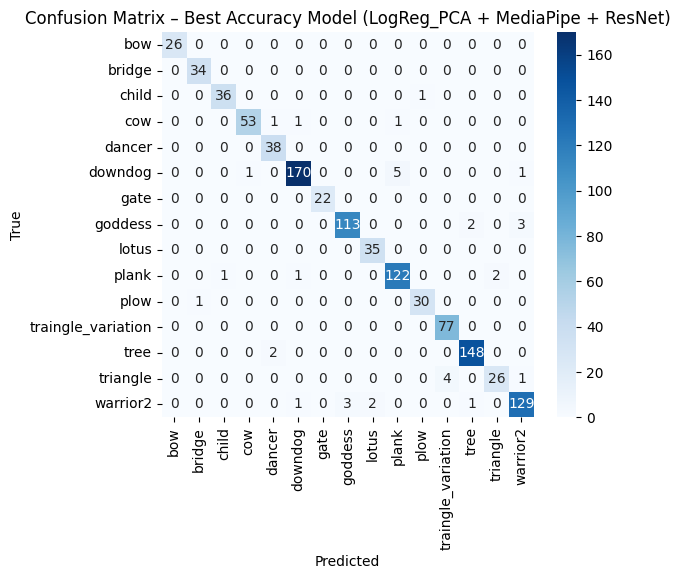

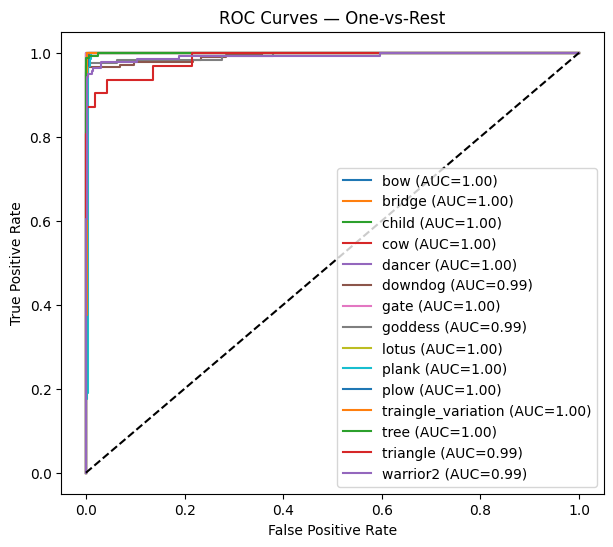


Classification Report:

                    precision    recall  f1-score   support

               bow       1.00      0.54      0.70        26
            bridge       1.00      0.85      0.92        34
             child       0.88      0.62      0.73        37
               cow       1.00      0.79      0.88        56
            dancer       0.90      0.92      0.91        38
           downdog       0.63      0.97      0.77       177
              gate       0.94      0.68      0.79        22
           goddess       0.99      0.86      0.92       118
             lotus       1.00      0.83      0.91        35
             plank       0.93      0.89      0.91       126
              plow       0.94      0.52      0.67        31
traingle_variation       0.91      0.91      0.91        77
              tree       0.95      0.92      0.94       150
          triangle       0.87      0.84      0.85        31
          warrior2       0.95      0.93      0.94       136

          acc

,Class,Precision,Recall,F1 Score,Support
0,bow,1.000000,0.538462,0.700000,26
1,bridge,1.000000,0.852941,0.920635,34
2,child,0.884615,0.621622,0.730159,37
3,cow,1.000000,0.785714,0.880000,56
4,dancer,0.897436,0.921053,0.909091,38
5,downdog,0.632353,0.971751,0.766147,177
6,gate,0.937500,0.681818,0.789474,22
7,goddess,0.990291,0.864407,0.923077,118
8,lotus,1.000000,0.828571,0.906250,35
9,plank,0.933333,0.888889,0.910569,126


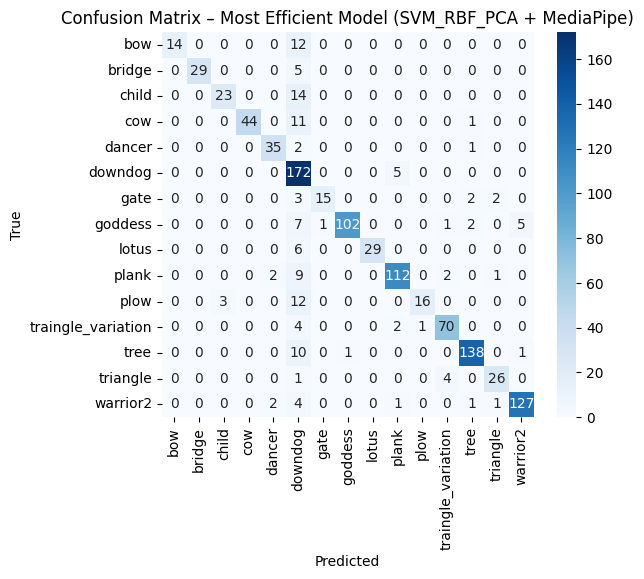

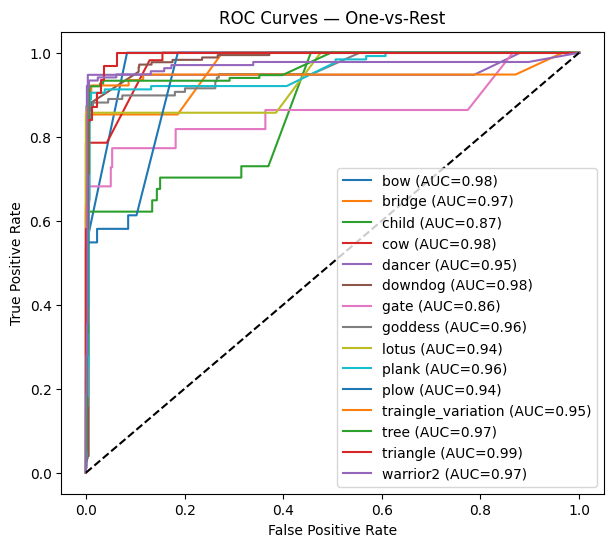

In [106]:
# Retrieve the data for each model's feature set
_, _, X_test_acc = features_dict[best_acc_feat]
_, _, X_test_eff = features_dict[best_eff_feat]

best_acc_pipeline = classifiers[best_acc_model](X_test_acc.shape[1])
best_acc_pipeline.fit(
    np.vstack([features_dict[best_acc_feat][0], features_dict[best_acc_feat][1]]),
    np.concatenate([y_train, y_val])
)

best_eff_pipeline = classifiers[best_eff_model](X_test_eff.shape[1])
best_eff_pipeline.fit(
    np.vstack([features_dict[best_eff_feat][0], features_dict[best_eff_feat][1]]),
    np.concatenate([y_train, y_val])
)

# Evaluate both
evaluate_classifier(
    f"Best Accuracy Model ({best_acc_model} + {best_acc_feat})",
    best_acc_pipeline,
    X_test_acc, y_test,
    class_names=CLASSES
)

evaluate_classifier(
    f"Most Efficient Model ({best_eff_model} + {best_eff_feat})",
    best_eff_pipeline,
    X_test_eff, y_test,
    class_names=CLASSES
)
